### Exploratory Data Analysis

In [186]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import re
import pickle
import warnings
import math
import calendar
import nltk,gensim,spacy
nltk.download('vader_lexicon')
from nltk.sentiment.vader import SentimentIntensityAnalyzer as SIA
from sklearn.decomposition import LatentDirichletAllocation, TruncatedSVD
from sklearn.feature_extraction.text import CountVectorizer, TfidfTransformer
from sklearn.model_selection import GridSearchCV
from gensim.summarization.summarizer import summarize
from gensim.summarization import keywords
#pd.set_option('display.max_rows', 500)
pd.set_option('max_colwidth', 50)
pd.set_option('display.max_columns', None)

from wordcloud import WordCloud,STOPWORDS

import plotly.express as ex
import plotly.graph_objs as go
import plotly.figure_factory as ff
from plotly.subplots import make_subplots
import plotly.offline as pyo
pyo.init_notebook_mode()
from IPython.display import HTML
!pip install unidecode

[nltk_data] Downloading package vader_lexicon to /root/nltk_data...
[nltk_data]   Package vader_lexicon is already up-to-date!


# Reading DATA

In [187]:
df=pd.read_csv('/content/drive/MyDrive/NLP/posts_data.csv')

# Initial Analysis

In [188]:
df.shape

(10437, 14)

In [189]:
df.head(4)

,source_id,source_name,author,title,description,url,url_to_image,published_at,content,is_top,total_reactions,total_comments,total_shares,total_plugin_comments
0,reuters,Reuters,Reuters Editorial,Portuguese drama 'A Herdade' chronicles one la...,A landowner must learn to adapt to changes swe...,https://www.reuters.com/article/us-filmfestiva...,https://s4.reutersmedia.net/resources_v2/image...,2019-09-05T15:37:20Z,"VENICE, Italy (Reuters) - A landowner must lea...",0.0,0.0,0.0,0.0,0.0
1,abc-news,ABC News,The Associated Press,Queer style kicks off NY Fashion Week with inc...,In celebration of gender-fluid fashion and inc...,https://abcnews.go.com/Entertainment/wireStory...,https://s.abcnews.com/images/Lifestyle/WireAP_...,2019-09-06T15:27:54Z,In celebration of gender-fluid fashion and inc...,0.0,0.0,0.0,0.0,0.0
2,the-irish-times,The Irish Times,Charlie Taylor,Huckletree to open fintech-focused co-working ...,Co-working space provider co-founded by Irishm...,https://www.irishtimes.com/business/technology...,https://www.irishtimes.com/polopoly_fs/1.40237...,2019-09-19T12:00:38Z,"Huckletree, a pan-European co-working space pr...",0.0,0.0,0.0,0.0,0.0
3,the-new-york-times,The New York Times,Abby Goodnough,Pelosi’s Drug Plan Would Let U.S. Negotiate Pr...,Speaker Nancy Pelosi unveils her bill to fight...,https://www.nytimes.com/2019/09/19/us/politics...,https://static01.nyt.com/images/2019/09/19/wor...,2019-09-19T13:00:04Z,"Most notably, the bill would require drug comp...",0.0,622.0,147.0,149.0,0.0


**Information Regarding the dataset**
1.	Sourceid column value indicates publisher unique identifier usually presented as lowercase sourcename with spaces replaced with hypen symbol.
3.	Source_name column value indicates publisher name.
4.	Author column value indicates article author. Some publishers do not share information about authors of their news, in this case usually source_name replaces that information.
5.	Title column value indicates headline of an article.
6.	Description column value indicates short article description usually visible in popups or recommendation boxes on the publisher's website. This field is shortened to a few sentences content column.
7.	Url column value indicates URL (Uniform Resource Locator) for article located on the publisher website.
8.	Urltoimage column value indicates a URL to the main image associated with the article.
9.	Published_at column value indicates the exact date and time of publishing the article. Date and time are presented in UTC (+000) time format.
10.	Content column value indicates the unformatted content of the article. This field is truncated to 260 characters.
11.	Top_article column value indicates article listed as a top article on publisher website. This field can have only two values, 1 when the article is contained in the popular/top articles group and 0 otherwise.




### Checking for missing Values




In [190]:
NA = pd.DataFrame(data=[df.isna().sum().tolist(), ["{:.2f}".format(i)+'%' \
            for i in (df.isna().sum()/df.shape[0]*100).tolist()]], 
            columns=df.columns, index=['NA Count', 'NA Percent']).T.\
            sort_values(by='NA Count',ascending =False)
NA.style.background_gradient(cmap="summer", subset=['NA Count'])

,NA Count,NA Percent
content,1292,12.38%
author,1020,9.77%
url_to_image,656,6.29%
total_reactions,118,1.13%
total_comments,118,1.13%
total_shares,118,1.13%
total_plugin_comments,118,1.13%
description,24,0.23%
title,2,0.02%
is_top,2,0.02%


In [377]:
fig = make_subplots(
    rows=2, cols=2,
    shared_xaxes=True,
    vertical_spacing=0.03,
    specs=[[{"type": "heatmap",'rowspan':2},{"type": "table",'rowspan':2}],
           [None             ,None],
          ]
)

fig.add_trace(
    go.Heatmap(
        z=df.isna().T.astype(int),
        x=np.arange(0,len(df)),
        y=df.columns
    ),
    row=1, col=1
)

fig.add_trace(
    go.Table(
    header=dict(values=list(['Feature Name','Number Of Missing']),
                fill_color='royalblue',
                font_color='white',
                font_size=13,
                align='left'),
    cells=dict(values=[df.columns,df.isna().sum().to_frame()[0]],
               fill_color='azure',
               font_size=14,
               align='left')),
    row=1, col=2
)




fig.update_layout(
    height=800,
    showlegend=False,
    title_text="Proportion Of Missing Values",
)
HTML(fig.to_html())

Most of the missing value is present in content section,as description features contains most of valuable info from content we will drop content section later 




### Handling of missing values and redundant features
we will drop redundant features such as url,source_id,url_to_image,content



In [192]:
df=df.drop(columns=['url','source_id','url_to_image'])

We have 24 rows without description ,we can populated  this feature from content if it is not empty

In [193]:
print(df[df['description'].isna()].isna().sum())
df = df[~df['title'].isna()]
df_2 = df.copy()

source_name               0
author                   13
title                     0
description              24
published_at              0
content                  18
is_top                    0
total_reactions           0
total_comments            0
total_shares              0
total_plugin_comments     0
dtype: int64


As you can see 18 of them are without contents , these 18 we'll be droping them cause we cant do something to fix them if we don't even know the content of this article

In [194]:
df = df_2.copy()
empty_desc = df[df['description'].isna()]
df = df[~df['description'].isna()]
empty_desc = empty_desc[~empty_desc['content'].isna()]
df = pd.concat([df,empty_desc],axis=0)
df.isna().sum()

source_name                 0
author                   1005
title                       0
description                 6
published_at                1
content                  1274
is_top                      2
total_reactions           118
total_comments            118
total_shares              118
total_plugin_comments     118
dtype: int64

For the last 6 empty descriptions we're gonna use summarize from gensim library to summarize the content and save it as a description

In [195]:
empty_desc = df[df['description'].isna()]
df = df[~df['description'].isna()]
empty_desc['description'] = empty_desc.apply(lambda x:summarize(x['content'],ratio=0.5),axis=1)
#Grabing back our new descriptions
df = pd.concat([df,empty_desc],axis=0)

As now we have used content feature for imputation of Description we will drop content features as it redundant and conatins high missing values 

In [196]:
df=df.drop(columns=['content'])

Author column value indicates article author. Some publishers do not share information about authors of their news, in this case usually source_name replaces that information.We will do the same below

In [197]:
df["author"].fillna(df["source_name"], inplace=True)

Finale feature list 

In [198]:
NA = pd.DataFrame(data=[df.isna().sum().tolist(), ["{:.2f}".format(i)+'%' \
            for i in (df.isna().sum()/df.shape[0]*100).tolist()]], 
            columns=df.columns, index=['NA Count', 'NA Percent']).T.\
            sort_values(by='NA Count',ascending =False)
NA.style.background_gradient(cmap="summer", subset=['NA Count'])

,NA Count,NA Percent
total_reactions,118,1.13%
total_comments,118,1.13%
total_shares,118,1.13%
total_plugin_comments,118,1.13%
is_top,2,0.02%
published_at,1,0.01%
source_name,0,0.00%
author,0,0.00%
title,0,0.00%
description,0,0.00%


As we have taken care of most of the missing/null values and only small portion of our data is still missing values we will simply drop those entries



In [199]:
print('number of records before dropping',df.shape)
df = df.dropna()
print('number of records before dropping',df.shape)

number of records before dropping (10417, 10)
number of records before dropping (10299, 10)


In [200]:
NA = pd.DataFrame(data=[df.isna().sum().tolist(), ["{:.2f}".format(i)+'%' \
            for i in (df.isna().sum()/df.shape[0]*100).tolist()]], 
            columns=df.columns, index=['NA Count', 'NA Percent']).T.\
            sort_values(by='NA Count',ascending =False)
NA.style.background_gradient(cmap="summer", subset=['NA Count'])

,NA Count,NA Percent
source_name,0,0.00%
author,0,0.00%
title,0,0.00%
description,0,0.00%
published_at,0,0.00%
is_top,0,0.00%
total_reactions,0,0.00%
total_comments,0,0.00%
total_shares,0,0.00%
total_plugin_comments,0,0.00%


# Count Features analysis
Intial analysis

In [201]:
info = df.describe()
info.loc['Skewness'] = df.skew()
info.loc['Kurtosis'] = df.kurt()
info.loc['Median'] = df.median()
info

,is_top,total_reactions,total_comments,total_shares,total_plugin_comments
count,10299.000000,10299.000000,10299.000000,10299.000000,10299.000000
mean,0.112050,382.078260,124.221963,196.529372,0.011652
std,0.315443,4437.617610,966.265730,1021.642749,0.268535
min,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.000000,0.000000,0.000000,1.000000,0.000000
50%,0.000000,1.000000,0.000000,8.000000,0.000000
75%,0.000000,43.000000,12.000000,48.000000,0.000000
max,1.000000,354132.000000,48490.000000,39422.000000,15.000000
Skewness,2.460196,54.402631,26.879594,19.093655,39.563539
Kurtosis,4.053349,4021.658394,1045.088909,556.974362,1877.830325


We will analyise total_plugin_comments 75% values are 0

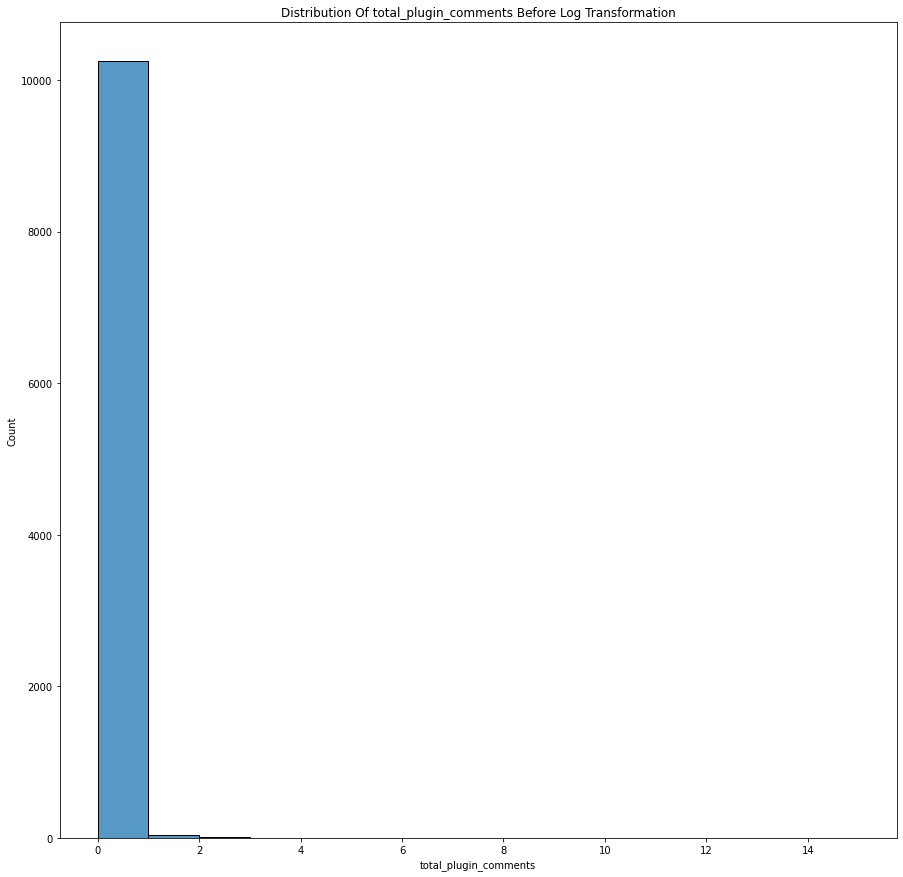

In [202]:
plt.figure(figsize=(15,15))
plt.title("Distribution Of total_plugin_comments Before Log Transformation")
sns.histplot(df.total_plugin_comments)



We see that most values in 	total_plugin_comments are zero. Let's check out how many zero values there are.



In [203]:
zerov = df[df['total_plugin_comments'] == 0].shape[0]
nonzerov = df[df['total_plugin_comments'] != 0].shape[0]

print(f'Number of zero values in `	total_plugin_comments`: {zerov}')
print(f'Number of non-zero values in `	total_plugin_comments`: {nonzerov}')
print(f'percentage of non-zero values in `	total_plugin_comments `:{(nonzerov/zerov)*100}')

Number of zero values in `	total_plugin_comments`: 10249
Number of non-zero values in `	total_plugin_comments`: 50
percentage of non-zero values in `	total_plugin_comments `:0.4878524734120402


We see that only  0.4%  values in engagement_comment_plugin_count are non-zero. Due to the extremely low variance, we will remove this column

In [204]:
df.drop(['total_plugin_comments'],axis=1,inplace=True)

Interestingly we see that the total Reaction Count feature distribution is very rigged and has large outliers but after we performed a log transformation we got a smooth bimodal distribution.

What is really beautiful is that all other the count features provided in the dataset follow the same effect and turn into bimodal distributions after being log normalized.


/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning:

Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



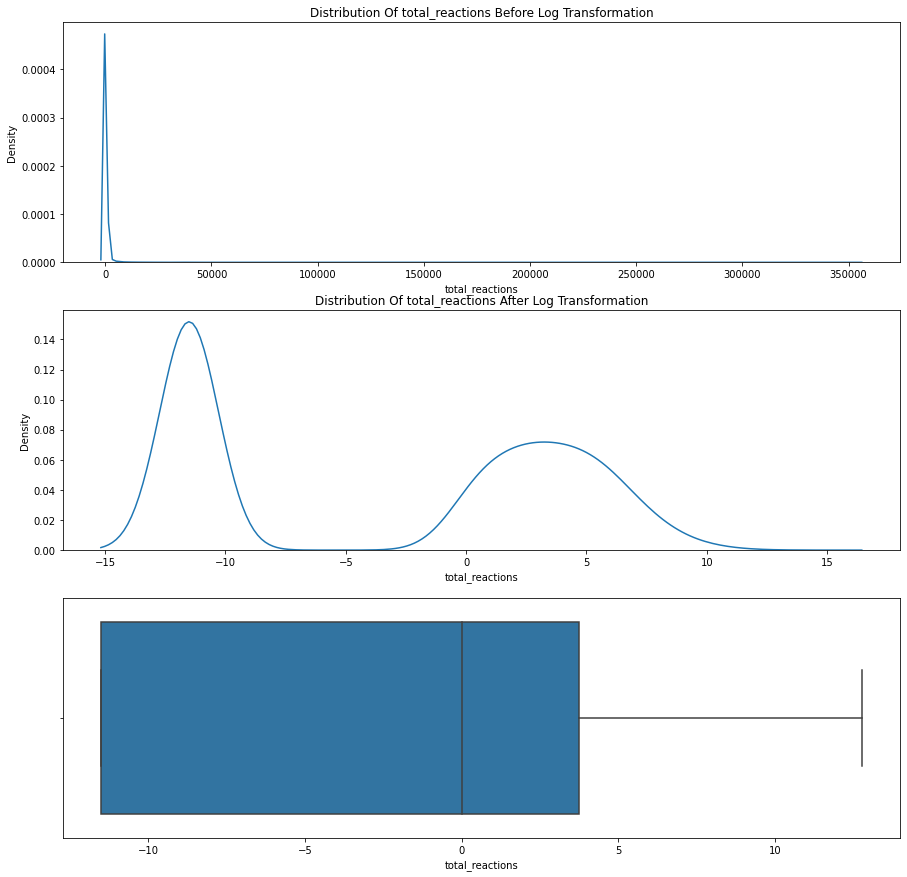

In [205]:
plt.figure(figsize=(15,15))
plt.subplot(3,1,1)
plt.title("Distribution Of total_reactions Before Log Transformation")
sns.kdeplot(df.total_reactions)
plt.subplot(3,1,2)
plt.title("Distribution Of total_reactions After Log Transformation")
sns.kdeplot(np.log(df.total_reactions+0.00001))
# df.total_reactions = np.log(df.total_reactions+0.00001)
plt.subplot(3,1,3)
sns.boxplot(np.log(df.total_reactions+0.00001))
plt.show()

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning:

Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



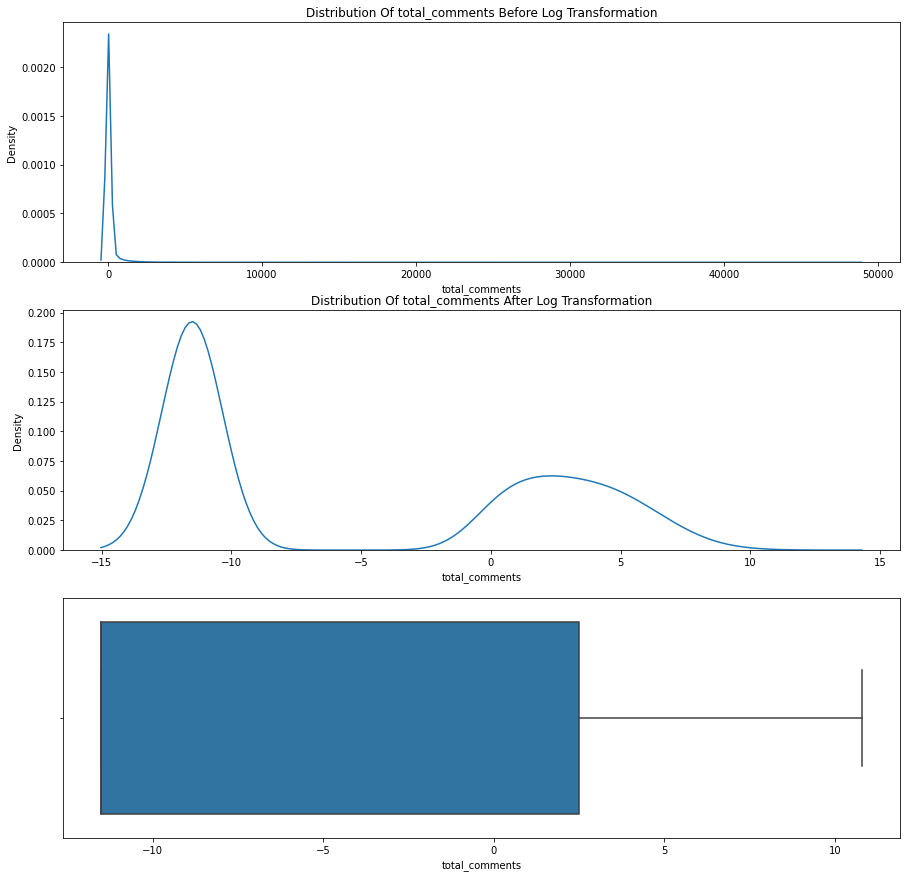

In [206]:
plt.figure(figsize=(15,15))
plt.subplot(3,1,1)
plt.title("Distribution Of total_comments Before Log Transformation")
sns.kdeplot(df.total_comments)
plt.subplot(3,1,2)
plt.title("Distribution Of total_comments After Log Transformation")
sns.kdeplot(np.log(df.total_comments+0.00001))
# df.total_comments = np.log(df.total_comments+0.00001)
plt.subplot(3,1,3)
sns.boxplot(np.log(df.total_comments+0.00001))
plt.show()

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning:

Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



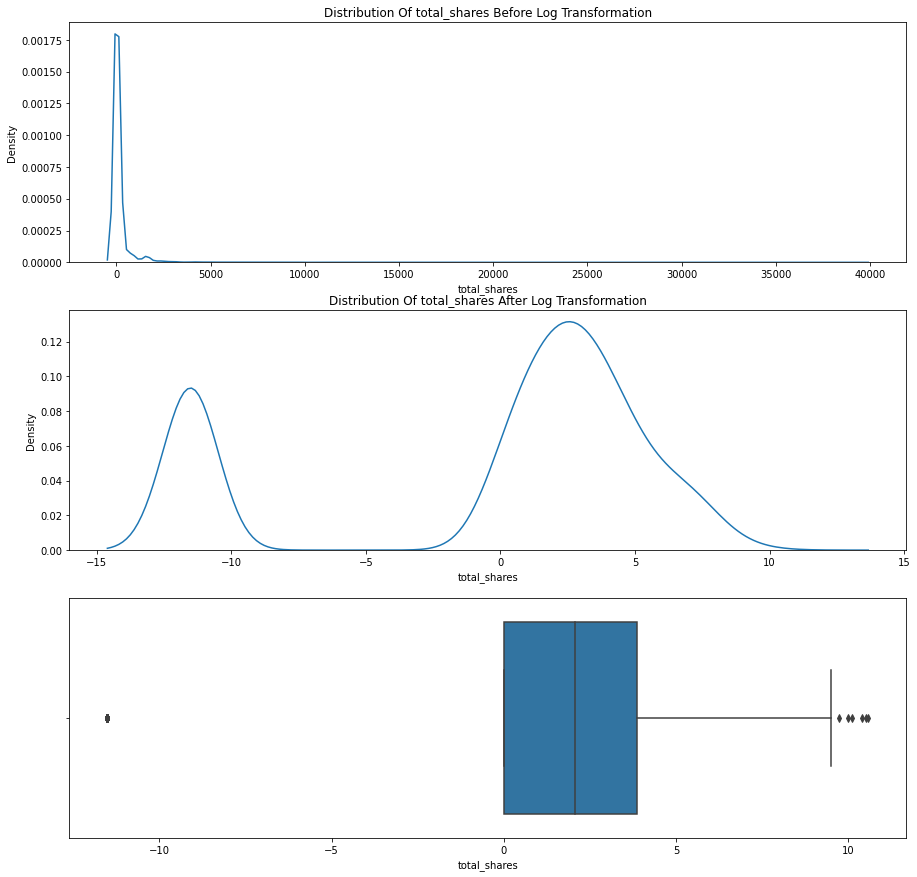

In [207]:
plt.figure(figsize=(15,15))
plt.subplot(3,1,1)
plt.title("Distribution Of total_shares Before Log Transformation")
sns.kdeplot(df.total_shares)
plt.subplot(3,1,2)
plt.title("Distribution Of total_shares After Log Transformation")
sns.kdeplot(np.log(df.total_shares+0.00001))
# df.total_shares = np.log(df.total_shares+0.00001)
plt.subplot(3,1,3)
sns.boxplot(np.log(df.total_shares+0.00001))
plt.show()

Check correlation between count features and is_top feature

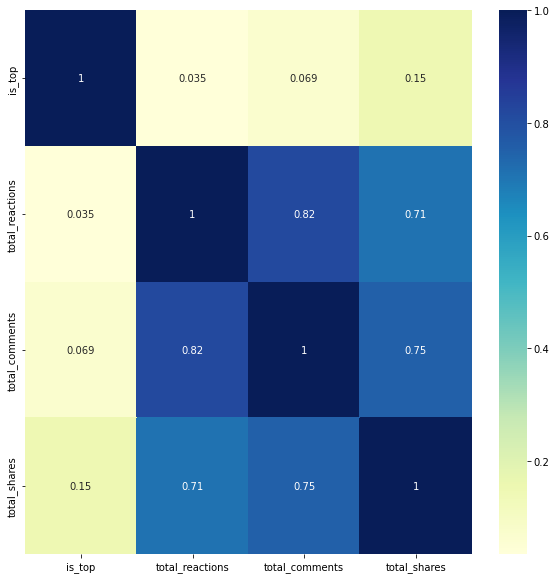

In [208]:
plt.figure(figsize=(10,10))
df_temp=df[['is_top',	'total_reactions',	'total_comments',	'total_shares']]
dataplot = sns.heatmap(df_temp.corr(),
                       cmap="YlGnBu", annot=True)
  
# displaying heatmap
plt.show()

We can see all user engagement features are postively correlated with each others where as use engagement features has very little effect on whether the article is top or not 

#  Leaders based on top_articles and user engagement

In [209]:

fig=ex.pie(df,names='is_top',title='Proportion Of Articles Marked As "TOP ARTICLE" ')
HTML(fig.to_html())

Text(0.5, 0, 'Number Of Articles')

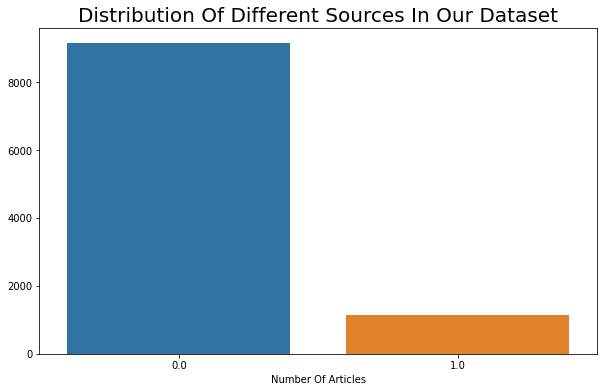

In [210]:
plt.figure(figsize=(10,6))
plt.title("Distribution Of Different Sources In Our Dataset",fontsize=20)
sns.barplot(y=df.is_top.value_counts().values,x=df.is_top.value_counts().index)
plt.xlabel('Number Of Articles')


In [211]:
def top_article_per_publisher(df):
    epp = []
    publishers = list(df['source_name'].unique())
    engagement_columns = ['is_top']
    for ec in engagement_columns:
        df_eng = df.groupby(['source_name'])[ec].agg('sum')
        epp.append((ec, df_eng.tolist()))
        
    return publishers, epp



publishers, engagements_per_publisher = top_article_per_publisher(df)

fig = go.Figure(go.Bar(x = publishers, y=engagements_per_publisher[0][1], name=engagements_per_publisher[0][0]))

for eng_name, eng_results in engagements_per_publisher[1:]: 
    fig.add_trace(go.Bar(x = publishers, y=eng_results , name=eng_name))

fig.update_layout(barmode='stack', xaxis={'categoryorder':'array'})

HTML(fig.to_html())

Wall street Journal has best top article ratio compared to others where as the irish time has the worst top article ratio

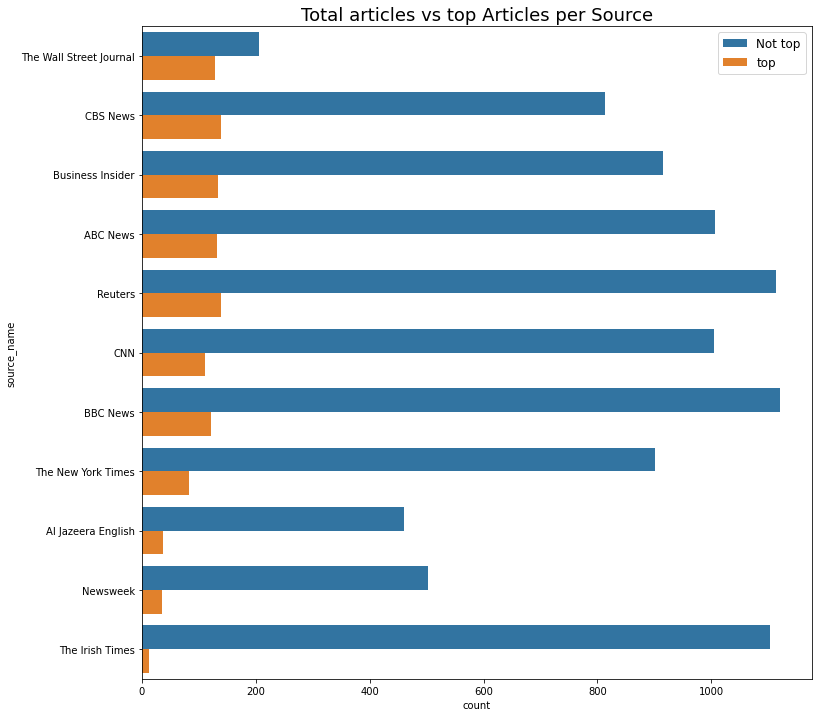

In [212]:
# Viewing top newsdesks by proportion of popularity
g_index = df['source_name'].head(20).values
g_df = df[df['source_name'].isin(g_index)]
order = g_df.groupby('source_name').mean()['is_top'].sort_values(ascending=False).index
plt.figure(figsize=(12,12))
sns.countplot(data=g_df, y='source_name', hue='is_top', order=order)
plt.legend(labels=['Not top', 'top'], fontsize=12, loc='best')
plt.title('Total articles vs top Articles per Source', fontsize=18);

Text(0.5, 0, 'Number Of Articles')

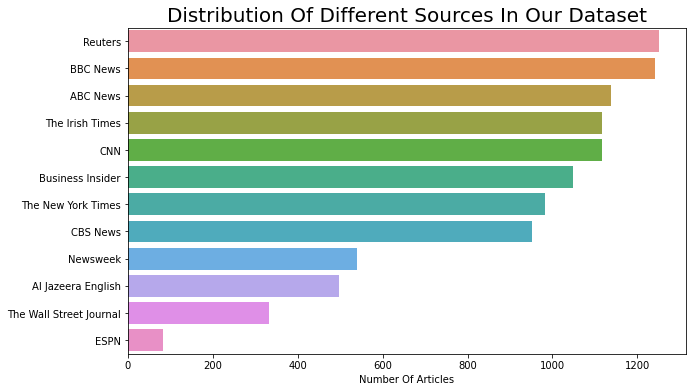

In [213]:
plt.figure(figsize=(10,6))
plt.title("Distribution Of Different Sources In Our Dataset",fontsize=20)
sns.barplot(x=df.source_name.value_counts().values,y=df.source_name.value_counts().index)
plt.xlabel('Number Of Articles')


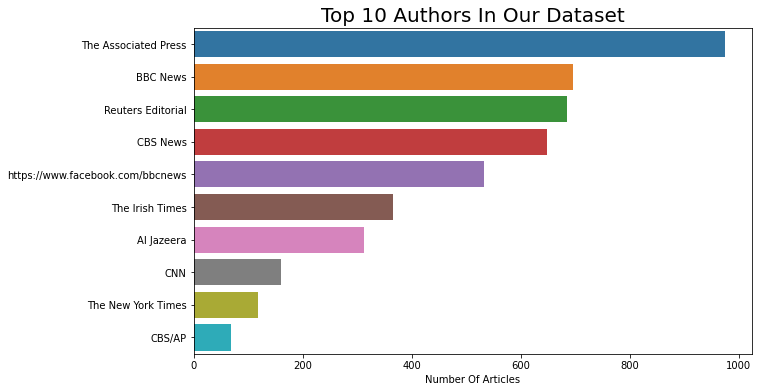

In [214]:
plt.figure(figsize=(10,6))
plt.title("Top 10 Authors In Our Dataset",fontsize=20)
sns.barplot(x=df.author.value_counts()[:10].values,y=df.author.value_counts()[:10].index)
plt.xlabel('Number Of Articles')
plt.show()

Engagement per publisher

In [215]:
def engagement_per_publisher(df):
    epp = []
    publishers = list(df['source_name'].unique())
    engagement_columns = ['total_reactions', 'total_comments', 'total_shares']
    for ec in engagement_columns:
        df_eng = df.groupby(['source_name'])[ec].agg('sum')
        epp.append((ec, df_eng.tolist()))
    return publishers, epp


publishers, engagements_per_publisher = engagement_per_publisher(df)

fig = go.Figure(go.Bar(x = publishers, y=engagements_per_publisher[0][1], name=engagements_per_publisher[0][0]))

for eng_name, eng_results in engagements_per_publisher[1:]: 
    fig.add_trace(go.Bar(x = publishers, y=eng_results , name=eng_name))

fig.update_layout(barmode='stack', xaxis={'categoryorder':'array'})
HTML(fig.to_html())

engagement_reaction_count (total reactions) grouped by source name

In [216]:
# is_top	total_reactions	total_comments	total_shares	total_plugin_comments

engagement_reaction_count = df.groupby('source_name')['total_reactions'].sum()
engagement_reaction_count.to_frame()

,total_reactions
source_name,
ABC News,343779.0
Al Jazeera English,140410.0
BBC News,545396.0
Business Insider,216545.0
CBS News,459741.0
CNN,1218153.0
ESPN,0.0
Newsweek,93167.0
Reuters,16963.0


the engagement comment score(total_comments) grouped by source name

In [217]:
engagement_comment_count = df.groupby('source_name')['total_comments'].sum()
engagement_comment_count.to_frame()

,total_comments
source_name,
ABC News,102708.0
Al Jazeera English,46005.0
BBC News,207558.0
Business Insider,101292.0
CBS News,170960.0
CNN,344880.0
ESPN,0.0
Newsweek,32426.0
Reuters,7101.0


the engagement share score(total_shares) grouped by source name

In [218]:
engagement_share_count = df.groupby('source_name')['total_shares'].sum()
engagement_share_count.to_frame()

,total_shares
source_name,
ABC News,82662.0
Al Jazeera English,36031.0
BBC News,200636.0
Business Insider,311678.0
CBS News,108155.0
CNN,327264.0
ESPN,0.0
Newsweek,29067.0
Reuters,647095.0


The reason why I calculated the engagement is to show how is  the user interaction in that news,more interaction it have a better result for a news reaching new reader.

In [219]:
final_engagement_score = engagement_reaction_count + engagement_comment_count + engagement_share_count 
final_engagement_score = final_engagement_score // 10000
final_engagement_score.to_frame()

,0
source_name,
ABC News,52.0
Al Jazeera English,22.0
BBC News,95.0
Business Insider,62.0
CBS News,73.0
CNN,189.0
ESPN,0.0
Newsweek,15.0
Reuters,67.0


This is for tell us how much are the author in the dataset,it also tell us how much an news produced by each author

In [220]:
highest_source = df['source_name'].value_counts()
highest_source.to_frame()

,source_name
Reuters,1252
BBC News,1242
ABC News,1139
The Irish Times,1116
CNN,1116
Business Insider,1048
The New York Times,983
CBS News,952
Newsweek,539
Al Jazeera English,497


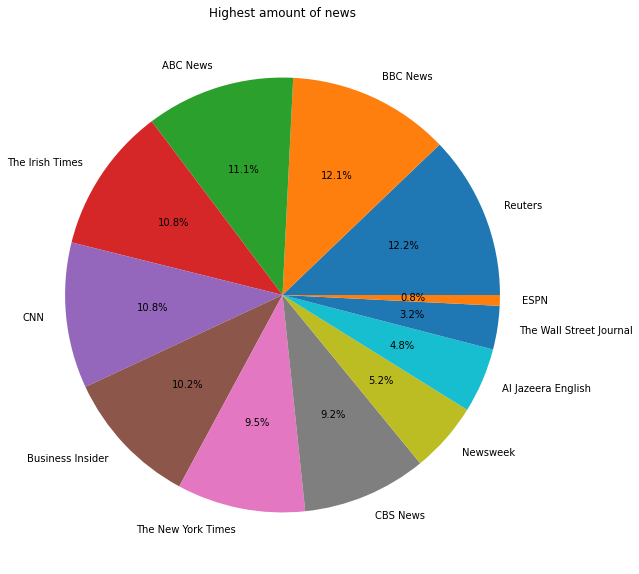

In [221]:
plt.figure(figsize=(10,10))
label = list(highest_source.index.values)
plt.pie(highest_source,labels=label,autopct='%1.1f%%')
plt.title('Highest amount of news')
plt.show()

In communication science there is a called opinion leader.Opinion leader is a someone,public figure,organization,goverments or mass media who have a large amount of influence to other people in a certain issue.In this case we can see how much impact a mass media created by looking at their all engagement score

In [222]:
final_engagement_score = final_engagement_score.sort_values(ascending=False)
final_engagement_score.to_frame()

,0
source_name,
CNN,189.0
The New York Times,124.0
BBC News,95.0
CBS News,73.0
Reuters,67.0
Business Insider,62.0
ABC News,52.0
Al Jazeera English,22.0
The Wall Street Journal,15.0


We want to find an opinion leader in here so we only take the top 5 of the author

In [223]:
five_highest_engagement_score = final_engagement_score[:5]
five_highest_engagement_score.to_frame()

,0
source_name,
CNN,189.0
The New York Times,124.0
BBC News,95.0
CBS News,73.0
Reuters,67.0


Text(0.5, 1.0, 'Opinion Leader by Total Engagement ')

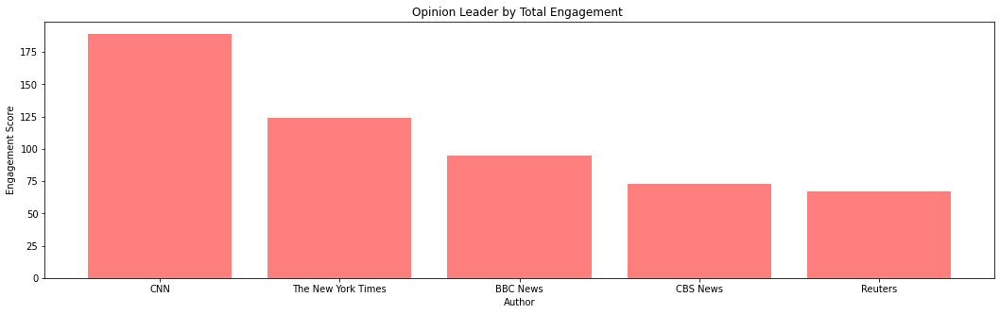

In [224]:
label = list(five_highest_engagement_score.index.values)
f, ax = plt.subplots(figsize=(18,5))
ax.bar(label,five_highest_engagement_score,color='red', alpha=0.5)
ax.set(xlabel='Author',
      ylabel='Engagement Score')
plt.title('Opinion Leader by Total Engagement ')

Another question is,are opinion leader having a high engagement just by the amount of articel they produced?".We can check by scatter

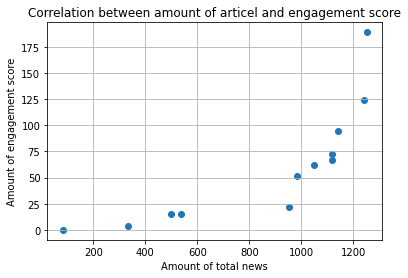

In [225]:
plt.scatter(highest_source,final_engagement_score)
plt.xlabel('Amount of total news')
plt.ylabel('Amount of engagement score')
plt.title('Correlation between amount of articel and engagement score')
plt.grid()
plt.show()

#feature engineering based on source of news

In [226]:
df['source_name_orig'] = df['source_name']
df = pd.get_dummies(data=df, columns=['source_name'],prefix=["source_name"])
df.rename(columns={'source_name_orig': 'source_name'}, inplace=True)

In [227]:
df.head()

,author,title,description,published_at,is_top,total_reactions,total_comments,total_shares,source_name,source_name_ABC News,source_name_Al Jazeera English,source_name_BBC News,source_name_Business Insider,source_name_CBS News,source_name_CNN,source_name_ESPN,source_name_Newsweek,source_name_Reuters,source_name_The Irish Times,source_name_The New York Times,source_name_The Wall Street Journal
0,Reuters Editorial,Portuguese drama 'A Herdade' chronicles one la...,A landowner must learn to adapt to changes swe...,2019-09-05T15:37:20Z,0.0,0.0,0.0,0.0,Reuters,0,0,0,0,0,0,0,0,1,0,0,0
1,The Associated Press,Queer style kicks off NY Fashion Week with inc...,In celebration of gender-fluid fashion and inc...,2019-09-06T15:27:54Z,0.0,0.0,0.0,0.0,ABC News,1,0,0,0,0,0,0,0,0,0,0,0
2,Charlie Taylor,Huckletree to open fintech-focused co-working ...,Co-working space provider co-founded by Irishm...,2019-09-19T12:00:38Z,0.0,0.0,0.0,0.0,The Irish Times,0,0,0,0,0,0,0,0,0,1,0,0
3,Abby Goodnough,Pelosi’s Drug Plan Would Let U.S. Negotiate Pr...,Speaker Nancy Pelosi unveils her bill to fight...,2019-09-19T13:00:04Z,0.0,622.0,147.0,149.0,The New York Times,0,0,0,0,0,0,0,0,0,0,1,0
4,BBC News,Rugby World Cup: Anthony Watson says England w...,England back Anthony Watson says England will ...,2019-09-05T15:36:38Z,0.0,0.0,0.0,2.0,BBC News,0,0,1,0,0,0,0,0,0,0,0,0


In the plot we can see more article written it will have more engagement which will have more traffic and more people will see the ads in the author page.So a lot of online mass media more care about the amount of total news rather than the quality

Distribution of the number of articles published by each newspaper is quite uneven. For example: the dataset contains over 1k articles published by Reuters, yet there are only  82  articles published by ESPN.
Reuters, BBC news and ABC news have the biggest number of articles in the dataset. Yet the most shared articles are those of CNN, NY times and Reuters. 

Furthermore, the most reacted to articles are published by NY times, CNN and CBS news.

# Text based analysis

We will create extra text features which will provide information about about how the length,sentiment of text ,words and topic effect the article popularity and quality

The idea here is check the effect of length and quality of title and descrption using below features

In [228]:
#we will only use this column to generate sentiment and drop it later
df['combi_text'] = df['title'] + '. ' + df['description']
df['combi_text_len'] = df['combi_text'].astype(str).apply(lambda x: len(x))

Sentiment plays a notable role in determining popularity. People are more likely to comment on articles with headlines that have negative sentiment, and less likely to comment on articles with headlines that have neutral sentiment. Previous research has shown that content that evokes high-arousal positive (awe) or negative (anger or anxiety) emotions tends to be more viral.

In [313]:
# Instantiating sentiment intensity analyzer
sia = SIA()


df['Sentiment']= df.combi_text.apply(lambda x:sia.polarity_scores(x))
df['DESC_Positive Sentiment']   = df.Sentiment.apply(lambda x: x['pos'])
df['DESC_Neutral Sentiment']    = df.Sentiment.apply(lambda x: x['neu'])
df['DESC_Negative Sentiment']   = df.Sentiment.apply(lambda x: x['neg'])
df['compound']   = df.Sentiment.apply(lambda x: x['compound'])


def sentiment(score):
    emotion = ""
    if score >= 0.5:
        emotion = "Positive"
    elif score <= -0.5:
        emotion = "Negative"
    else:
        emotion = "Neutral"
    return emotion


df.drop(columns=['Sentiment'],inplace=True)
df.drop(columns=['combi_text'],inplace=True)

df["Sentiment"] = df["compound"].apply(sentiment)
df.drop(columns=['compound'],inplace=True)


In [315]:
def engagement_per_publisher(df):
    epp = []
    publishers = list(df['Sentiment'].unique())
    engagement_columns = ['total_reactions', 'total_comments', 'total_shares']
    for ec in engagement_columns:
        df_eng = df.groupby(['Sentiment'])[ec].agg('sum')
        epp.append((ec, df_eng.tolist()))
    return publishers, epp


publishers, engagements_per_publisher = engagement_per_publisher(df)

fig = go.Figure(go.Bar(x = publishers, y=engagements_per_publisher[0][1], name=engagements_per_publisher[0][0]))

for eng_name, eng_results in engagements_per_publisher[1:]: 
    fig.add_trace(go.Bar(x = publishers, y=eng_results , name=eng_name))

fig.update_layout(barmode='stack', xaxis={'categoryorder':'array'})
HTML(fig.to_html())


In [312]:
def engagement_per_duplicate_title(df):
    epp = []
    publishers = list(df['DESC_Positive Sentiment'].unique())
    engagement_columns = ['total_reactions', 'total_comments', 'total_shares']
    for ec in engagement_columns:
        df_eng = df.groupby(['is_duplicated'])[ec].agg('sum')
        epp.append((ec, df_eng.tolist()))
    return publishers, epp


publishers, engagements_per_publisher = engagement_per_duplicate_title(df)
print(publishers, engagements_per_publisher)
fig = go.Figure(go.Bar(x = publishers, y=engagements_per_publisher[0][1], name=engagements_per_publisher[0][0]))

for eng_name, eng_results in engagements_per_publisher[1:]: 
    fig.add_trace(go.Bar(x = publishers, y=eng_results , name=eng_name))

fig.update_layout(barmode='stack', xaxis={'categoryorder':'array'})
HTML(fig.to_html())

[0.0, 0.072, 0.047, 0.149, 0.063, 0.077, 0.095, 0.053, 0.163, 0.228, 0.073, 0.197, 0.155, 0.091, 0.117, 0.14, 0.165, 0.154, 0.297, 0.086, 0.167, 0.113, 0.069, 0.162, 0.11, 0.114, 0.081, 0.082, 0.064, 0.052, 0.158, 0.102, 0.036, 0.279, 0.168, 0.12, 0.071, 0.415, 0.306, 0.088, 0.079, 0.123, 0.118, 0.184, 0.085, 0.09, 0.099, 0.266, 0.231, 0.128, 0.103, 0.087, 0.041, 0.139, 0.083, 0.125, 0.202, 0.05, 0.131, 0.187, 0.183, 0.18, 0.152, 0.105, 0.058, 0.101, 0.147, 0.07, 0.138, 0.193, 0.129, 0.132, 0.151, 0.04, 0.124, 0.031, 0.195, 0.048, 0.112, 0.061, 0.098, 0.257, 0.076, 0.116, 0.03, 0.046, 0.043, 0.104, 0.075, 0.078, 0.109, 0.36, 0.035, 0.261, 0.107, 0.057, 0.111, 0.196, 0.355, 0.134, 0.026, 0.074, 0.08, 0.1, 0.115, 0.108, 0.136, 0.119, 0.174, 0.049, 0.199, 0.126, 0.096, 0.145, 0.238, 0.093, 0.175, 0.084, 0.127, 0.15, 0.262, 0.153, 0.144, 0.033, 0.178, 0.264, 0.121, 0.097, 0.141, 0.293, 0.032, 0.234, 0.23, 0.067, 0.259, 0.204, 0.06, 0.042, 0.137, 0.068, 0.16, 0.054, 0.248, 0.045, 0.133, 0.3

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning:

Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



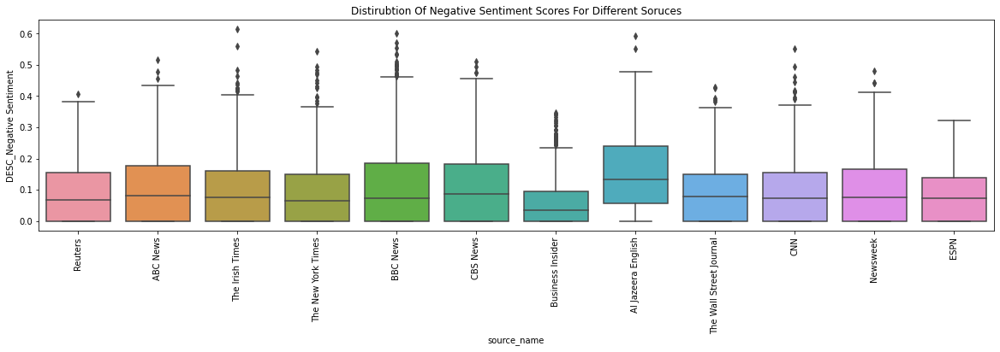

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning:

Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



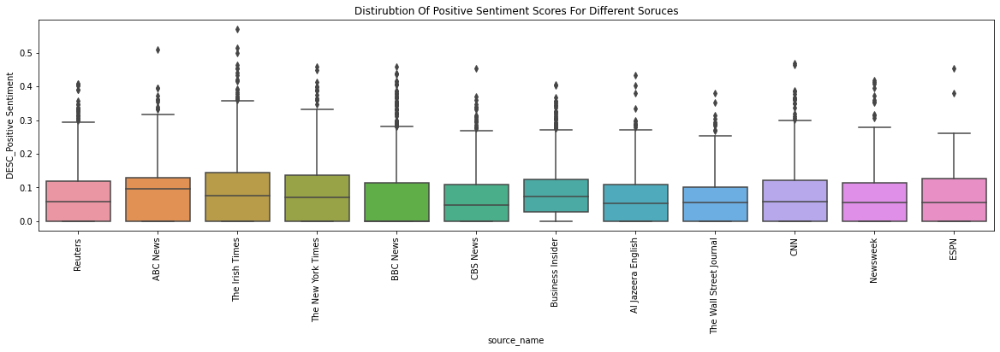

In [230]:
plt.figure(figsize=(20,10))


plt.subplot(2,1,1)
plt.title("Distirubtion Of Negative Sentiment Scores For Different Soruces")
ax = sns.boxplot(df['source_name'],df['DESC_Negative Sentiment'])
ax.set_xticklabels(ax.get_xticklabels(),rotation=90)
plt.show()
plt.figure(figsize=(20,10))

plt.subplot(2,1,2)
plt.title("Distirubtion Of Positive Sentiment Scores For Different Soruces")
ax = sns.boxplot(df['source_name'],df['DESC_Positive Sentiment'])
ax.set_xticklabels(ax.get_xticklabels(),rotation=90)
plt.show()

We can see that as far as positive and negative sentiment most of our sources have fairly similar distributions and mean values but at the same time we can observe that some of our sources have noticeable range differences !

<Figure size 720x720 with 0 Axes>

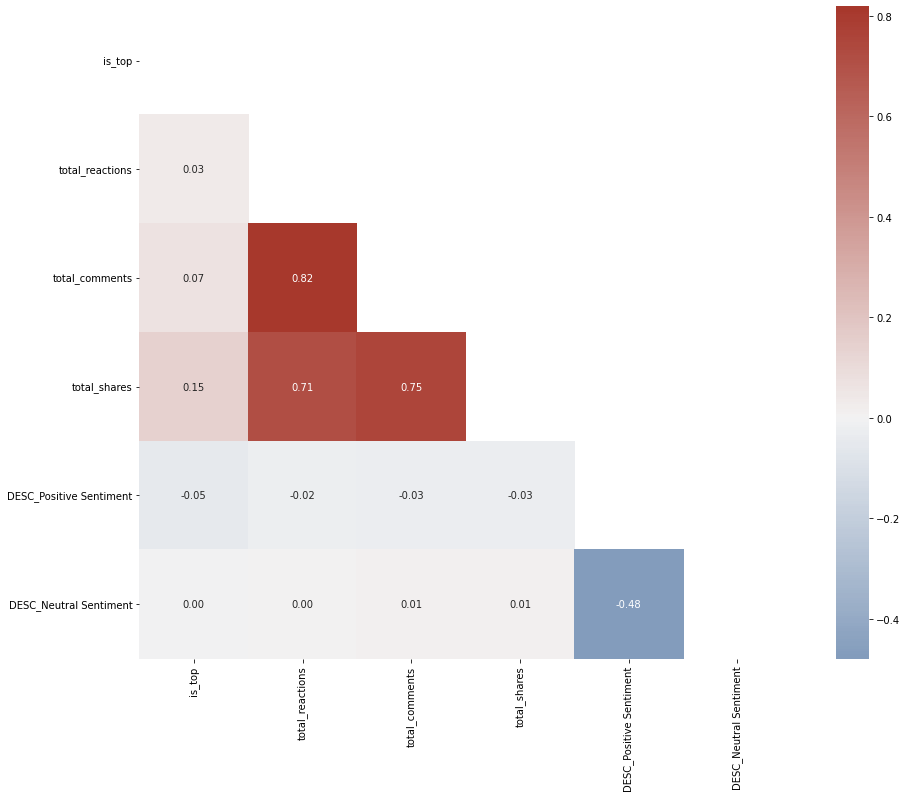

In [231]:
plt.figure(figsize=(10,10))
df_temp=df[['is_top',	'total_reactions',	'total_comments',	'total_shares','DESC_Positive Sentiment', 'DESC_Neutral Sentiment']]

matrix =df_temp.corr()

mask = np.triu(np.ones_like(matrix, dtype=bool))

cmap = sns.diverging_palette(250, 15, s=75, l=40,
                            n=9, center="light", as_cmap=True)

plt.figure(figsize=(16, 12))
sns.heatmap(matrix, mask=mask, center=0, annot=True,
            fmt='.2f', square=True, cmap=cmap)

plt.show()

Although sentiment of article plays a important but in our data set its effect on popularity as well deciding top article is not strongly evident .But among all sentiments negative sentiments of article are popular as comapred to other sentiments.

###Checking for Duplicates
There alot duplicated headlines in our data. These are likely recurring weekly or monthly articles or on same topic

In [232]:
df['title'].duplicated().sum()

534

In [233]:
df[df['title'].duplicated()]['title'].value_counts().head(10)

Quickly catch up on the day's news                                                                  5
Today in History                                                                                    3
Some LSE investors call on Hong Kong exchange to up bid by 20%, add cash                            3
Canada says it is seeking WTO consultations with China over canola export ban                       3
Fed will continue to act 'as appropriate' to sustain U.S. growth                                    3
In Mugabe's village, relatives say he was very bitter before death                                  3
Reuters asks judge to release secret Propecia documents                                             3
Foreign leaders, supporters bid farewell to Zimbabwe's Mugabe                                       3
After LSE's sharp rebuff, HKEX begins investor charm offensive                                      3
Exclusive: Ahead of trade talks, China makes biggest U.S. soybean purchases since 

#Feature engeering based on duplicate

In [298]:
df['is_duplicated'] = np.where(df['title'].duplicated() == True, 1, 0)
df[df['title'].duplicated() == True]['is_top'].value_counts()

0.0    447
1.0     87
Name: is_top, dtype: int64

In [235]:
print('Number of comments on duplicate title',df[df['title'].duplicated() == True]['total_comments'].count())
print('Number of comments on distinct title',df[df['title'].duplicated() == False]['total_comments'].count())
print('Number of reactions on duplicate title',df[df['title'].duplicated() == True]['total_reactions'].count())
print('Number of reactions on distinct title',df[df['title'].duplicated() == False]['total_reactions'].count())
print('Number of shares on duplicate title',df[df['title'].duplicated() == True]['total_shares'].count())
print('Number of shares on distinct title',df[df['title'].duplicated() == False]['total_shares'].count())



Number of comments on duplicate title 534
Number of comments on distinct title 9765
Number of reactions on duplicate title 534
Number of reactions on distinct title 9765
Number of shares on duplicate title 534
Number of shares on distinct title 9765


As we can see duplicate arctiles are quite unpopular.

In [306]:
def engagement_per_duplicate_title(df):
    epp = []
    publishers = list(df['is_duplicated'].unique())
    engagement_columns = ['total_reactions', 'total_comments', 'total_shares']
    for ec in engagement_columns:
        df_eng = df.groupby(['is_duplicated'])[ec].agg('sum')
        epp.append((ec, df_eng.tolist()))
    return publishers, epp


publishers, engagements_per_publisher = engagement_per_duplicate_title(df)

fig = go.Figure(go.Bar(x = publishers, y=engagements_per_publisher[0][1], name=engagements_per_publisher[0][0]))

for eng_name, eng_results in engagements_per_publisher[1:]: 
    fig.add_trace(go.Bar(x = publishers, y=eng_results , name=eng_name))

fig.update_layout(barmode='stack', xaxis={'categoryorder':'array'})
HTML(fig.to_html())


# Title / description Length
The idea here is that longer titles and descriptions will lead to less comments -- the easier the headline / abstract is to understand, the more comments the article will attract. We can see this seems to be a factor for the description, while title length doesn't seem to have much of an impact.

In [322]:
df['title_len'] = df['title'].apply(lambda x: len(x))
df['description_len'] = df['description'].apply(lambda x: len(x))
df['combi_text'] = df['title'] + '. ' + df['description']
df['title_description_len'] = df['combi_text'].apply(lambda x: len(x))

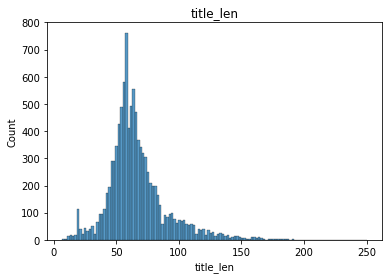

In [237]:
# plt.figure(figsize=(10,6))
# sns.histplot(data=df, x='title_len');
# xes[0, 0].plot(x, y)


plt.title("title_len")
sns.histplot(data=df, x='title_len')



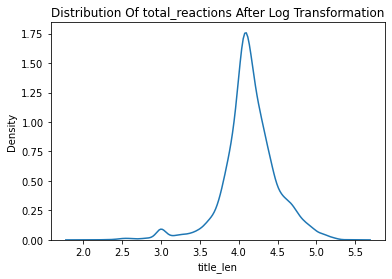

In [238]:
plt.title("Distribution Of total_reactions After Log Transformation")
sns.kdeplot(np.log(df.title_len+0.00001))

In [239]:
# sns.boxplot(np.log(df.total_shares+0.00001))
# plt.show()
info = df.describe()
info.loc['Skewness'] = df.skew()
info.loc['Kurtosis'] = df.kurt()
info.loc['Median'] = df.median()
info

,is_top,total_reactions,total_comments,total_shares,source_name_ABC News,source_name_Al Jazeera English,source_name_BBC News,source_name_Business Insider,source_name_CBS News,source_name_CNN,source_name_ESPN,source_name_Newsweek,source_name_Reuters,source_name_The Irish Times,source_name_The New York Times,source_name_The Wall Street Journal,combi_text_len,DESC_Positive Sentiment,DESC_Neutral Sentiment,DESC_Negative Sentiment,title_len,description_len,title_description_len
count,10299.000000,10299.000000,10299.000000,10299.000000,10299.000000,10299.000000,10299.000000,10299.000000,10299.000000,10299.000000,10299.000000,10299.000000,10299.000000,10299.000000,10299.000000,10299.000000,10299.000000,10299.000000,10299.000000,10299.000000,10299.000000,10299.000000,10299.000000
mean,0.112050,382.078260,124.221963,196.529372,0.110593,0.048257,0.120594,0.101757,0.092436,0.108360,0.007962,0.052335,0.121565,0.108360,0.095446,0.032333,227.492572,0.078181,0.824100,0.097720,66.799301,158.693271,227.492572
std,0.315443,4437.617610,966.265730,1021.642749,0.313643,0.214319,0.325671,0.302344,0.289655,0.310850,0.088878,0.222713,0.326799,0.310850,0.293844,0.176892,78.130474,0.084366,0.117738,0.107014,23.935179,65.839633,78.130474
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,46.000000,0.000000,0.348000,0.000000,7.000000,0.000000,46.000000
25%,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,165.000000,0.000000,0.746000,0.000000,54.000000,103.000000,165.000000
50%,0.000000,1.000000,0.000000,8.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,211.000000,0.062000,0.832000,0.072000,62.000000,142.000000,211.000000
75%,0.000000,43.000000,12.000000,48.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,290.000000,0.122000,0.909000,0.161000,75.000000,220.000000,290.000000
max,1.000000,354132.000000,48490.000000,39422.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,512.000000,0.570000,1.000000,0.614000,250.000000,266.000000,512.000000
Skewness,2.460196,54.402631,26.879594,19.093655,2.483603,4.216422,2.330447,2.634881,2.814682,2.520292,11.074354,4.020888,2.316461,2.520292,2.754058,5.288619,0.485446,1.229871,-0.418659,1.103248,1.378025,0.312791,0.485446
Kurtosis,4.053349,4021.658394,1045.088909,556.974362,4.169093,15.781281,3.431650,4.943557,5.923586,4.352719,120.664742,14.170293,3.366644,4.352719,5.585922,25.974533,-0.631718,1.620718,-0.251091,0.781142,3.776933,-1.216276,-0.631718


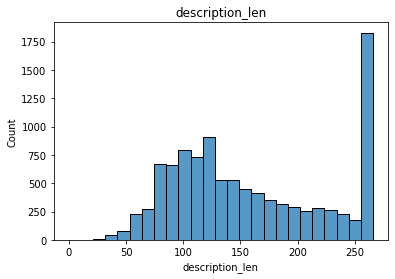

In [240]:
plt.title("description_len")
sns.histplot(data=df, x='description_len')

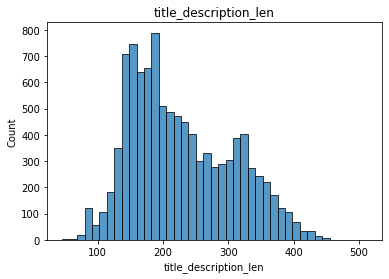

In [241]:

plt.title("title_description_len")
sns.histplot(data=df, x='title_description_len')

<Figure size 720x720 with 0 Axes>

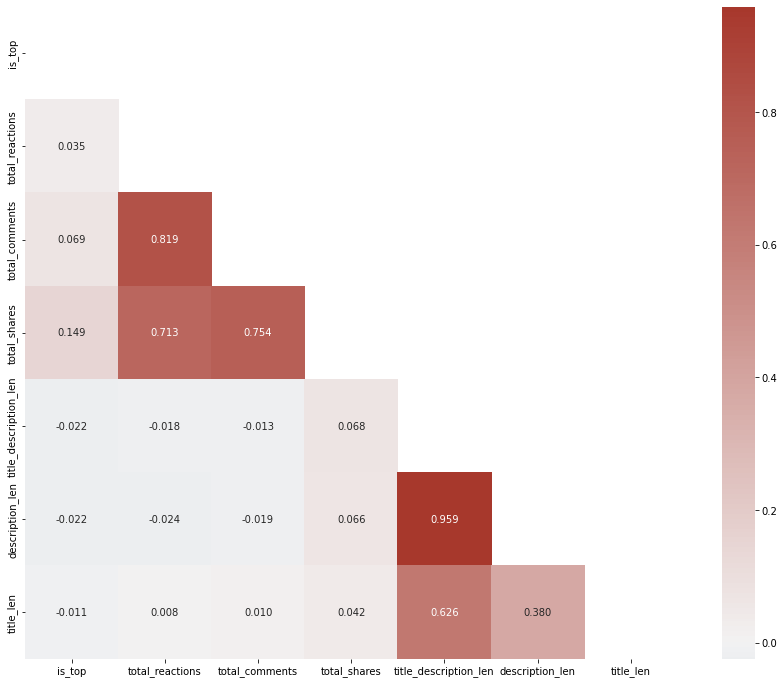

In [242]:
plt.figure(figsize=(10,10))
df_temp=df[['is_top',	'total_reactions',	'total_comments',	'total_shares','title_description_len','description_len','title_len']]

matrix =df_temp.corr()

mask = np.triu(np.ones_like(matrix, dtype=bool))

cmap = sns.diverging_palette(250, 15, s=75, l=40,
                            n=9, center="light", as_cmap=True)

plt.figure(figsize=(16, 12))
sns.heatmap(matrix, mask=mask, center=0, annot=True,
            fmt='.3f', square=True, cmap=cmap)

plt.show()

# Text analysis of title and description

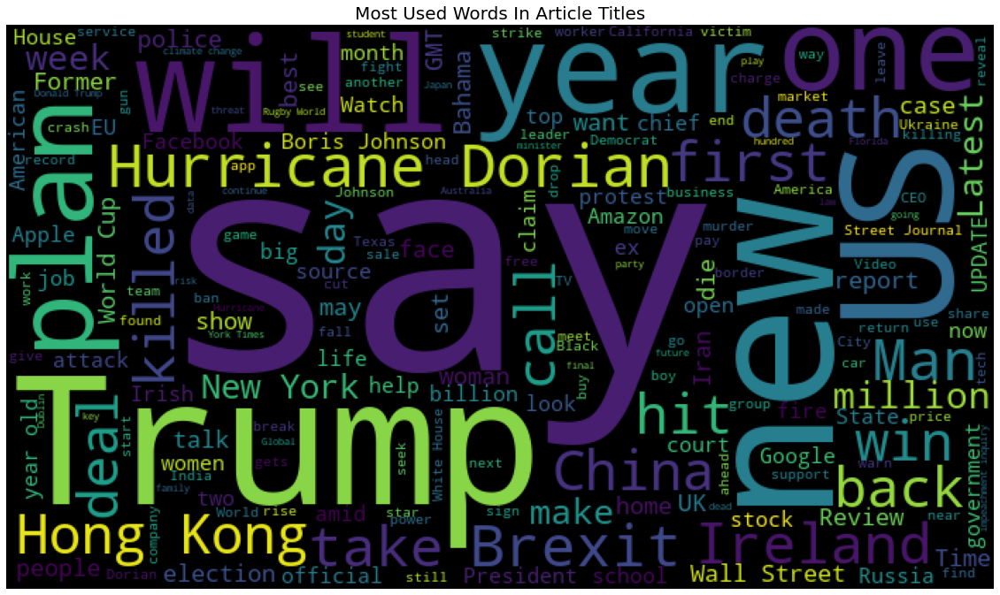

In [243]:
plt.figure(figsize=(20,20))
wc = WordCloud(width=700,height=400,stopwords=STOPWORDS).generate(' '.join(df.title))
plt.imshow(wc)
plt.axis('off')
plt.title("Most Used Words In Article Titles",fontsize=20)
plt.show()

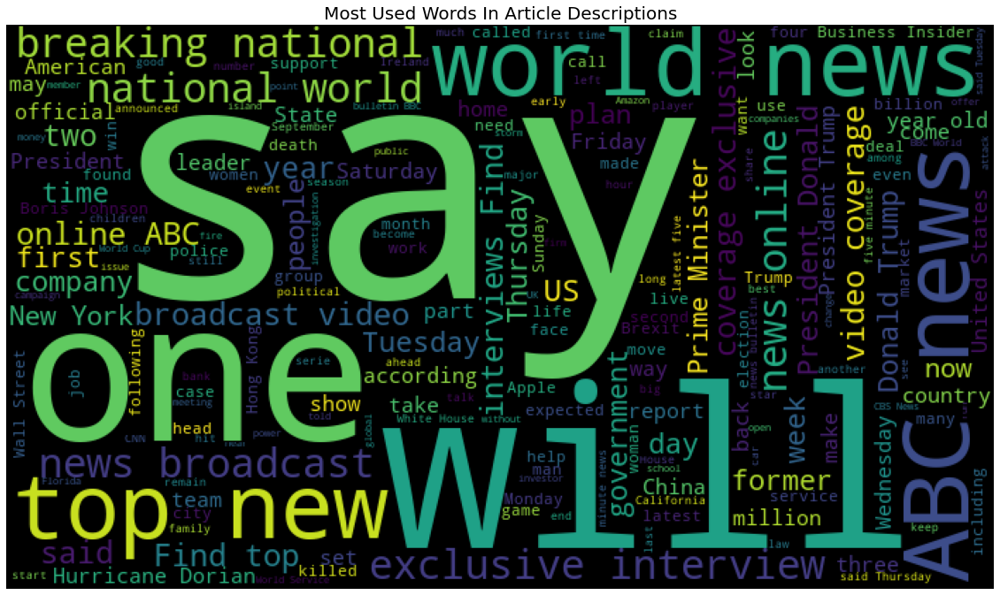

In [244]:
plt.figure(figsize=(20,20))

wc = WordCloud(width=700,height=400,stopwords=STOPWORDS).generate(' '.join(df.description))
plt.imshow(wc)
plt.axis('off')
plt.title("Most Used Words In Article Descriptions",fontsize=20)
plt.show()

# Data Preprocessing for topic modelling based on title and description
First, I'll follow these steps to clean the data and make it ready to apply the model:



1.  Remove special characters
2.  Tokenize data
3.  Lemmatize data




In [323]:
from unidecode import unidecode

df['combi_text'] = df['combi_text'].str.replace(r'[\!?.]+[\.]+','.', regex=True)
data = df.combi_text.values.tolist()
# Remove new line characters
data = [re.sub(r'\s+', ' ', sent) for sent in data]
# Remove distracting single quotes
data = [re.sub(r"\'", "", sent) for sent in data]
# Remove special characters
data = [re.sub('[^A-Za-z0-9]+', ' ', sent) for sent in data]
# Remove accentuation
data = [unidecode(text) for text in data]
print(data[:1])

['Portuguese drama A Herdade chronicles one landowners tale amid change A landowner must learn to adapt to changes sweeping his country in Portuguese film A Herdade The Domain a nearly three hour long drama about a domineering family patriarch ']


Tokenizing the data:

In [246]:

def sent_to_words(sentences):
    for sentence in sentences:
        yield(gensim.utils.simple_preprocess(str(sentence), deacc=True))  # deacc=True removes punctuations

data_words = list(sent_to_words(data))
print(data_words[:1])

[['portuguese', 'drama', 'herdade', 'chronicles', 'one', 'landowners', 'tale', 'amid', 'change', 'landowner', 'must', 'learn', 'to', 'adapt', 'to', 'changes', 'sweeping', 'his', 'country', 'in', 'portuguese', 'film', 'herdade', 'the', 'domain', 'nearly', 'three', 'hour', 'long', 'drama', 'about', 'domineering', 'family', 'patriarch']]


Lemmatizing the data:

In [247]:
def lemmatization(texts, allowed_postags=['NOUN', 'ADJ', 'VERB', 'ADV']): #'NOUN', 'ADJ', 'VERB', 'ADV'
    texts_out = []
    for sent in texts:
        doc = nlp(" ".join(sent)) 
        texts_out.append(" ".join([token.lemma_ if token.lemma_ not in ['-PRON-'] else '' for token in doc if token.pos_ in allowed_postags]))
    return texts_out

# Initialize spacy ‘en’ model, keeping only tagger component (for efficiency)
nlp = spacy.load('en', disable=['parser', 'ner'])
# Do lemmatization keeping only Noun, Adj, Verb, Adverb
data_lemmatized = lemmatization(data_words, allowed_postags=['NOUN', 'VERB']) #select noun and verb
print(data_lemmatized[:2])

['drama chronicle landowner tale change landowner must learn adapt change sweep country film herdade domain hour drama domineer', 'queer style kick week show celebration gender fashion inclusion kind style magazine throw start week']


Vectorizing and Creating the Model

I'll create the vector with the bag of words, and then apply TF-IDF to measure the importance of each word to the document. After that, I'll create the LDA Model.

In [248]:
vectorizer = CountVectorizer(analyzer='word',       
                             min_df=10,# minimum reqd occurences of a word 
                             stop_words='english',             # remove stop words
                             lowercase=True,                   # convert all words to lowercase
                             token_pattern='[a-zA-Z0-9]{3,}',  # num chars > 3
                             # max_features=50000,             # max number of uniq words    
)
data_vectorized = vectorizer.fit_transform(data_lemmatized)

In [249]:
#TF IDF
tfidf = TfidfTransformer(smooth_idf=True,use_idf=True)
tfidf.fit(data_vectorized)

data_tfidf = tfidf.transform(data_vectorized)

Finally, I'll build the LDA model: I won't do grid search, due to computational cost, but I'll test to find the best number of topics. After that, I'll print the model to check if lda_model contains the best one from the for loop.

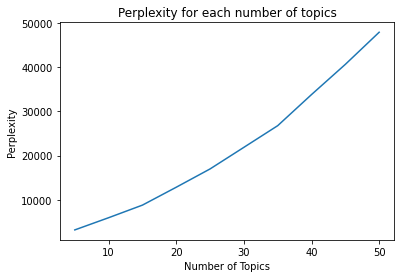

In [250]:
lw_perp = np.inf
lda_model = 0
perps = []
n_topics = list(range(5,55,5))

for topic in n_topics:
    lda = LatentDirichletAllocation(n_components=topic,               # Number of topics
                                          max_iter=10,               # Max learning iterations
                                          learning_method='online',   
                                          random_state=100,          # Random state
                                          batch_size=128,            # n docs in each learning iter
                                          evaluate_every = -1,       # compute perplexity every n iters, default: Don't
                                          n_jobs = -1,               # Use all available CPUs
                                         )
    lda.fit(data_tfidf)
    
    perp = lda.perplexity(data_tfidf)
    perps.append(perp)
    
    if perp <= lw_perp:
        lw_perp = perp
        lda_model = lda
    
lda_output = lda_model.fit_transform(data_tfidf)

plt.plot(n_topics, perps)
plt.xlabel('Number of Topics')
plt.ylabel('Perplexity')
plt.title('Perplexity for each number of topics')
plt.show()

Yes, we have now the LDA model with 3 components (topics).

Now, I want to see two things: First, which words are the most important for each topic, that I'll show using wordclouds, and in which topic each document is being placed.

In [251]:
def show_topics(vectorizer=vectorizer, lda_model=lda_model, n_words=20):
    keywords = np.array(vectorizer.get_feature_names())
    topic_keywords = []
    for topic_weights in lda_model.components_:
        top_keyword_locs = (-topic_weights).argsort()[:n_words]
        topic_keywords.append(keywords.take(top_keyword_locs))
    return topic_keywords

topic_keywords = show_topics(vectorizer=vectorizer, lda_model=lda_model, n_words=15)
df_topic_keywords = pd.DataFrame(topic_keywords)
df_topic_keywords.columns = ['Word '+str(i) for i in range(df_topic_keywords.shape[1])]
df_topic_keywords.index = ['Topic '+str(i) for i in range(df_topic_keywords.shape[0])]
df_topic_keywords

/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning:

Function get_feature_names is deprecated; get_feature_names is deprecated in 1.0 and will be removed in 1.2. Please use get_feature_names_out instead.



,Word 0,Word 1,Word 2,Word 3,Word 4,Word 5,Word 6,Word 7,Word 8,Word 9,Word 10,Word 11,Word 12,Word 13,Word 14
Topic 0,say,deal,company,market,trade,year,job,stock,sign,cut,talk,plan,turn,price,raise
Topic 1,win,team,election,look,time,game,watch,year,season,candidate,crash,say,run,week,play
Topic 2,news,video,break,coverage,interview,online,minute,bulletin,gmt,climate,trump,discuss,send,plan,challenge
Topic 3,school,say,woman,leader,impeachment,year,seek,student,gun,action,life,protest,confirm,son,complaint
Topic 4,say,attack,kill,man,police,people,official,death,storm,accuse,charge,claim,year,case,state


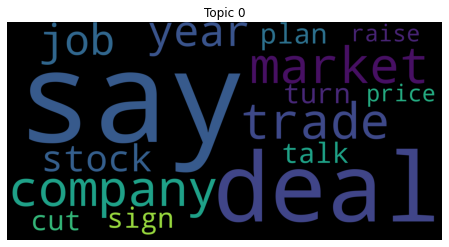

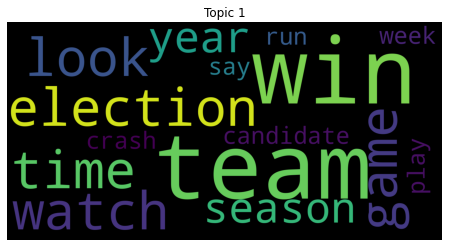

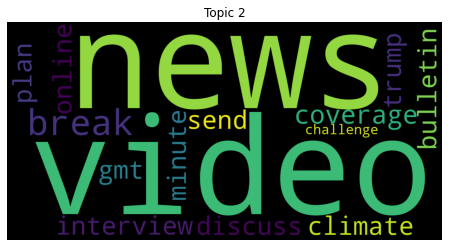

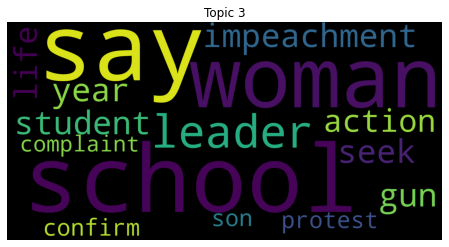

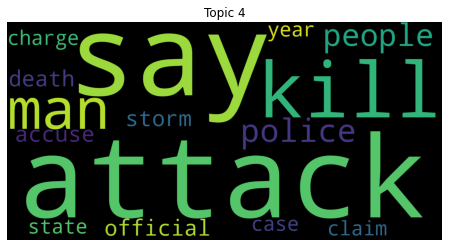

In [331]:
for topic in df_topic_keywords.index.values:
    summ = df_topic_keywords.loc[topic, :].values
    all_summary = " ".join(s for s in summ)
    stopwords = set(STOPWORDS)
    wordcloud = WordCloud(stopwords=stopwords,
                      background_color='black', width=1600,                            
                      height=800).generate(all_summary)
    
    fig, ax = plt.subplots(figsize=(10,4))            
    ax.imshow(wordcloud, interpolation='bilinear')       
    ax.set_axis_off()
    plt.title(topic)
    plt.imshow(wordcloud)  
    plt.savefig('xx')

In [328]:
topicnames = ["Topic" + str(i) for i in range(lda_model.n_components)]

docnames = df['combi_text']

# Make the pandas dataframe

df_document_topic = pd.DataFrame(np.round(lda_output, 2), columns=topicnames, index=docnames)
# Get dominant topic for each document
dominant_topic = np.argmax(df_document_topic.values, axis=1)
df['topic'] = dominant_topic


# docnames = df['combi_text']

# # Make the pandas dataframe

# df_document_topic = pd.DataFrame(np.round(lda_output, 2), columns=topicnames, index=docnames)
# # Get dominant topic for each document
# dominant_topic = np.argmax(df_document_topic.values, axis=1)
# df['title_topic'] = dominant_topic





In [326]:
df['topic'].value_counts()

Topic[0 4 0 ... 0 4 4]    10299
Name: topic, dtype: int64

In [255]:
df['topic'].value_counts()

4    2685
0    2543
1    2224
3    1583
2    1264
Name: topic, dtype: int64

#Featurer Enginenring Based on sentiment

In [256]:


df['topic_orig'] = df['topic']
df = pd.get_dummies(data=df, columns=['topic'])
df.rename(columns={'topic_orig': 'topic'}, inplace=True)
cluster_df=df

In [257]:
cluster_df=df
df.corr()['is_top'].sort_values(ascending=False).filter(like='topic')

topic      0.032396
topic_4    0.025345
topic_3    0.013336
topic_2   -0.001530
topic_0   -0.017805
topic_1   -0.018851
Name: is_top, dtype: float64

In [258]:
cluster_df.corr()['total_comments'].sort_values(ascending=False).filter(like='topic')

topic      0.028150
topic_3    0.021205
topic_4    0.013399
topic_2    0.008327
topic_0   -0.018376
topic_1   -0.020266
Name: total_comments, dtype: float64

In [259]:
cluster_df.corr()['total_shares'].sort_values(ascending=False).filter(like='topic')

topic_0    0.032927
topic_2    0.006438
topic_4    0.005112
topic_3   -0.002975
topic     -0.004842
topic_1   -0.042486
Name: total_shares, dtype: float64

In [260]:
cluster_df.corr()['total_reactions'].sort_values(ascending=False).filter(like='topic')

topic_3    0.017887
topic      0.015629
topic_4    0.007121
topic_2   -0.000891
topic_0   -0.005144
topic_1   -0.017174
Name: total_reactions, dtype: float64

In [261]:
def engagement_per_topic(df):
    epp = []
    publishers = list(df['topic'].unique())
    engagement_columns = ['total_reactions', 'total_comments', 'total_shares']
    for ec in engagement_columns:
        df_eng = df.groupby(['topic'])[ec].agg('sum')
        epp.append((ec, df_eng.tolist()))
    return publishers, epp


publishers, engagements_per_publisher = engagement_per_topic(df)

fig = go.Figure(go.Bar(x = publishers, y=engagements_per_publisher[0][1], name=engagements_per_publisher[0][0]))

for eng_name, eng_results in engagements_per_publisher[1:]: 
    fig.add_trace(go.Bar(x = publishers, y=eng_results , name=eng_name))

fig.update_layout(barmode='stack', xaxis={'categoryorder':'array'})
HTML(fig.to_html())

In [262]:
print(publishers)

[0, 4, 3, 1, 2]


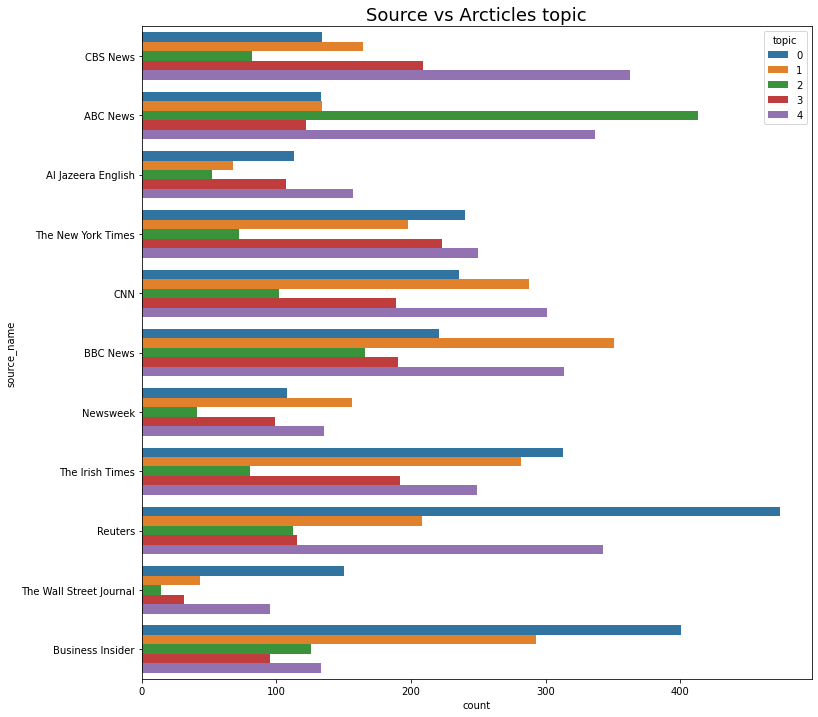

In [263]:
# Viewing top newsdesks by proportion of popularity
g_index = df['source_name'].head(20).values
g_df = df[df['source_name'].isin(g_index)]
order = g_df.groupby('source_name').mean()['topic'].sort_values(ascending=False).index
plt.figure(figsize=(12,12))
sns.countplot(data=g_df, y='source_name', hue='topic', order=order)
# plt.legend(labels=['Not top', 'top'], fontsize=12, loc='best')
plt.title('Source vs Arcticles topic', fontsize=18);

# EDA using Time features 
In this section, we're going to look at how time affects both the popularity and Top articles.



we will create extra time features which will  provide more info\rmation on  how time affects both the frequency and popularity of articles




In [264]:
df.published_at = pd.to_datetime(df.published_at)
df['day_of_month'] = df['published_at'].apply(lambda x: x.day)
df['month'] = df['published_at'].apply(lambda x: x.month)
df['day_of_week'] = df['published_at'].apply(lambda x: x.dayofweek)
df['hour'] = df['published_at'].apply(lambda x: x.hour)

# Month


In [332]:
def engagement_per_month(df):
    epp = []
    publishers = list(df['month'].unique())
    engagement_columns = ['total_reactions', 'total_comments', 'total_shares','is_top']
    for ec in engagement_columns:
        df_eng = df.groupby(['month'])[ec].agg('sum')
        epp.append((ec, df_eng.tolist()))
    return publishers, epp

publishers, engagements_per_publisher = engagement_per_month(df)

fig = go.Figure(go.Bar(x = publishers, y=engagements_per_publisher[0][1], name=engagements_per_publisher[0][0]))

for eng_name, eng_results in engagements_per_publisher[1:]: 
    fig.add_trace(go.Bar(x = publishers, y=eng_results , name=eng_name))

fig.update_layout(barmode='stack', xaxis={'categoryorder':'array'})

HTML(fig.to_html())

# Day of Week
There seems to be an inverse relationship between average popularity and the number articles opened for commentary. Average article popularity tends to be lower during the week, and higher on the weekend.

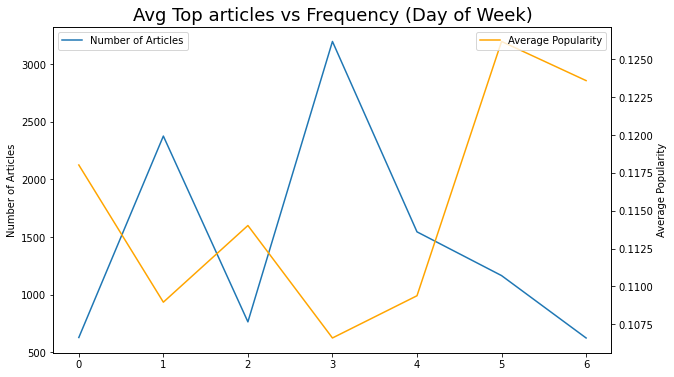

In [333]:
plt.figure(figsize=(10,6))
ax = sns.lineplot(data=df['day_of_week'].value_counts(), label='Number of Articles')
ax.set_ylabel('Number of Articles')
ax.legend(loc=2)
ax2 = ax.twinx()
sns.lineplot(data=df.groupby('day_of_week').mean()['is_top'], color='orange', ax=ax2, label='Average Popularity')
ax2.set_ylabel('Average Popularity')
ax2.legend(loc=1)
plt.title('Avg Top articles vs Frequency (Day of Week)', fontsize=18);

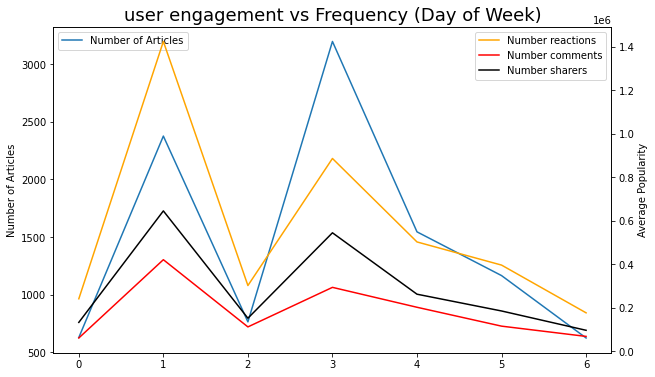

In [334]:
plt.figure(figsize=(10,6))
ax = sns.lineplot(data=df['day_of_week'].value_counts(), label='Number of Articles')
ax.set_ylabel('Number of Articles')
ax.legend(loc=2)   
ax2 = ax.twinx()
sns.lineplot(data=df.groupby('day_of_week')['total_reactions'].agg('sum'), color='orange', ax=ax2, label='Number reactions')
ax2.set_ylabel('Average Popularity')
sns.lineplot(data=df.groupby('day_of_week')['total_comments'].agg('sum'), color='red', ax=ax2, label='Number comments')
ax2.set_ylabel('Average Popularity')  
sns.lineplot(data=df.groupby('day_of_week')['total_shares'].agg('sum'), color='black', ax=ax2, label='Number sharers')
ax2.set_ylabel('Average Popularity')
ax2.legend(loc=1)
plt.title('user engagement vs Frequency (Day of Week)', fontsize=18);

In [338]:
def engagement_per_day_ofweek(df):
    epp = []
    publishers = list(df['day_of_week'].unique())
    engagement_columns = ['total_reactions', 'total_comments', 'total_shares','is_top']
    for ec in engagement_columns:
        df_eng = df.groupby(['day_of_week'])[ec].agg('sum')
        epp.append((ec, df_eng.tolist()))
    return publishers, epp

publishers, engagements_per_publisher = engagement_per_day_ofweek(df)

fig = go.Figure(go.Bar(x = publishers, y=engagements_per_publisher[0][1], name=engagements_per_publisher[0][0]))

for eng_name, eng_results in engagements_per_publisher[1:]: 
    fig.add_trace(go.Bar(x = publishers, y=eng_results , name=eng_name))

fig.update_layout(barmode='stack', xaxis={'categoryorder':'array'})

HTML(fig.to_html())

As we can observe for the plots user engagenment is dependent on number of articles published and not dependent on days articles are published on 

# Hour
Articles published between 10pm and 2am have a much higher average popularity

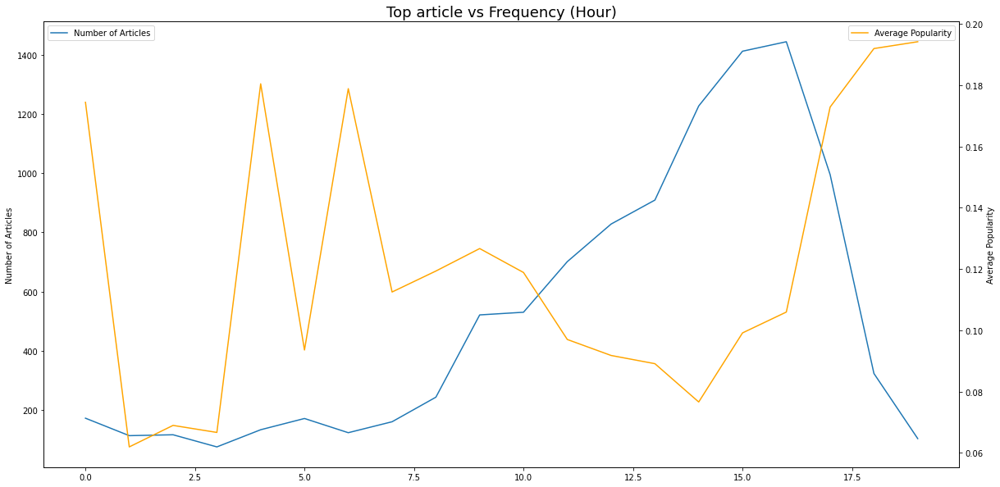

In [268]:
plt.figure(figsize=(20,10))
ax = sns.lineplot(data=df['hour'].value_counts(), label='Number of Articles')
ax.set_ylabel('Number of Articles')
ax.legend(loc=2)
ax2 = ax.twinx()
sns.lineplot(data=df.groupby('hour').mean()['is_top'], color='orange', ax=ax2, label='Average Popularity')
ax2.set_ylabel('Average Popularity')
ax2.legend(loc=1)
plt.title('Top article vs Frequency (Hour)', fontsize=18);

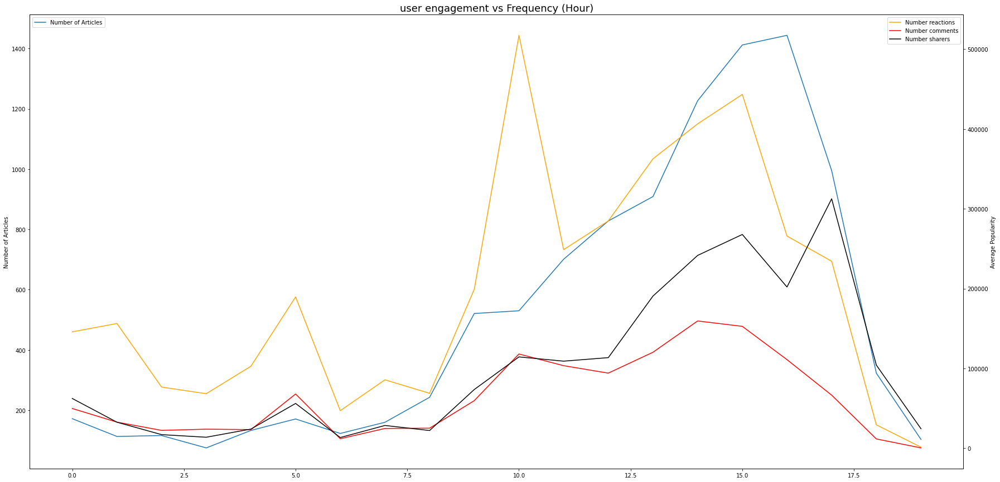

In [335]:
plt.figure(figsize=(30,15))
ax = sns.lineplot(data=df['hour'].value_counts(), label='Number of Articles')
ax.set_ylabel('Number of Articles')
ax.legend(loc=2)   
ax2 = ax.twinx()
sns.lineplot(data=df.groupby('hour')['total_reactions'].agg('sum'), color='orange', ax=ax2, label='Number reactions')
ax2.set_ylabel('Average Popularity')
sns.lineplot(data=df.groupby('hour')['total_comments'].agg('sum'), color='red', ax=ax2, label='Number comments')
ax2.set_ylabel('Average Popularity')  
sns.lineplot(data=df.groupby('hour')['total_shares'].agg('sum'), color='black', ax=ax2, label='Number sharers')
ax2.set_ylabel('Average Popularity')
ax2.legend(loc=1)
plt.title('user engagement vs Frequency (Hour)', fontsize=18);
plt.savefig('xx')

In [339]:
def engagement_per_day_ofweek(df):
    epp = []
    publishers = list(df['hour'].unique())
    engagement_columns = ['total_reactions', 'total_comments', 'total_shares','is_top']
    for ec in engagement_columns:
        df_eng = df.groupby(['hour'])[ec].agg('sum')
        epp.append((ec, df_eng.tolist()))
    return publishers, epp

publishers, engagements_per_publisher = engagement_per_day_ofweek(df)

fig = go.Figure(go.Bar(x = publishers, y=engagements_per_publisher[0][1], name=engagements_per_publisher[0][0]))

for eng_name, eng_results in engagements_per_publisher[1:]: 
    fig.add_trace(go.Bar(x = publishers, y=eng_results , name=eng_name))

fig.update_layout(barmode='stack', xaxis={'categoryorder':'array'})

HTML(fig.to_html())

In [344]:
df.total_shares = np.log(df.total_shares+0.00001)
df.total_reactions = np.log(df.total_reactions+0.00001)
df.total_comments = np.log(df.total_comments+0.00001)

#Feature importance plot


In [345]:
top_feats = abs(df._get_numeric_data().corr()['is_top']).sort_values(ascending=False).index[0:42]

In [346]:
print([col for col in df.columns if col not in top_feats])

['author', 'title', 'description', 'published_at', 'source_name', 'Sentiment', 'combi_text']


In [347]:
train = df[top_feats]

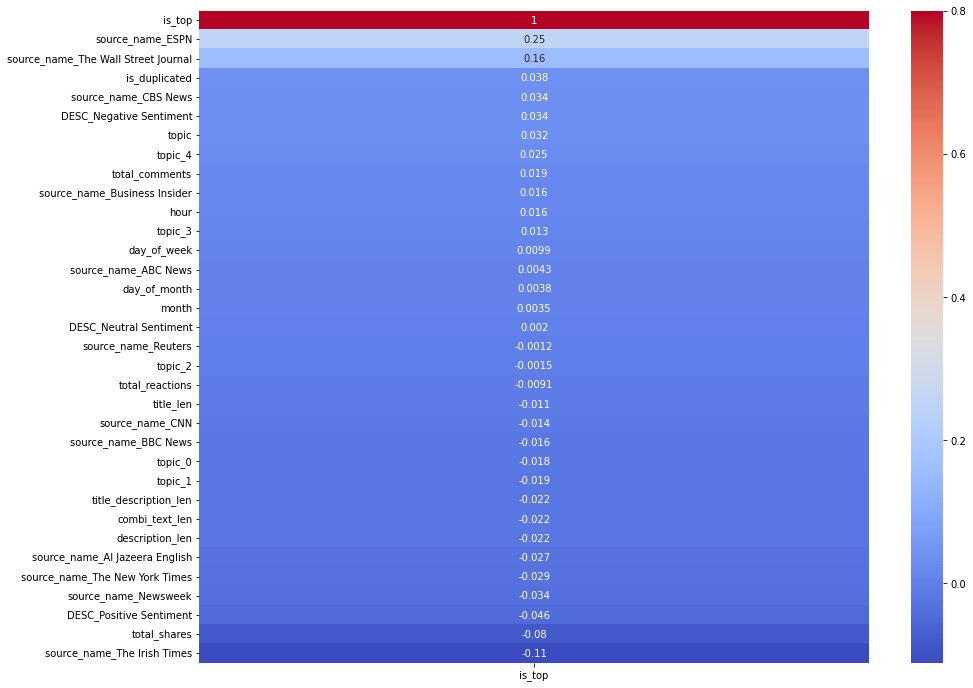

In [372]:
plt.figure(figsize=(15,12))
sns.heatmap(train.corr()[['is_top']].sort_values(ascending=False, by='is_top'), 
            cmap='coolwarm', annot=True, vmax=0.8)
plt.savefig('1')

In [359]:
top_feats = abs(df._get_numeric_data().corr()['total_comments']).sort_values(ascending=False).index[0:42]

In [ ]:
print([col for col in df.columns if col not in top_feats])

In [361]:
train = df[top_feats]

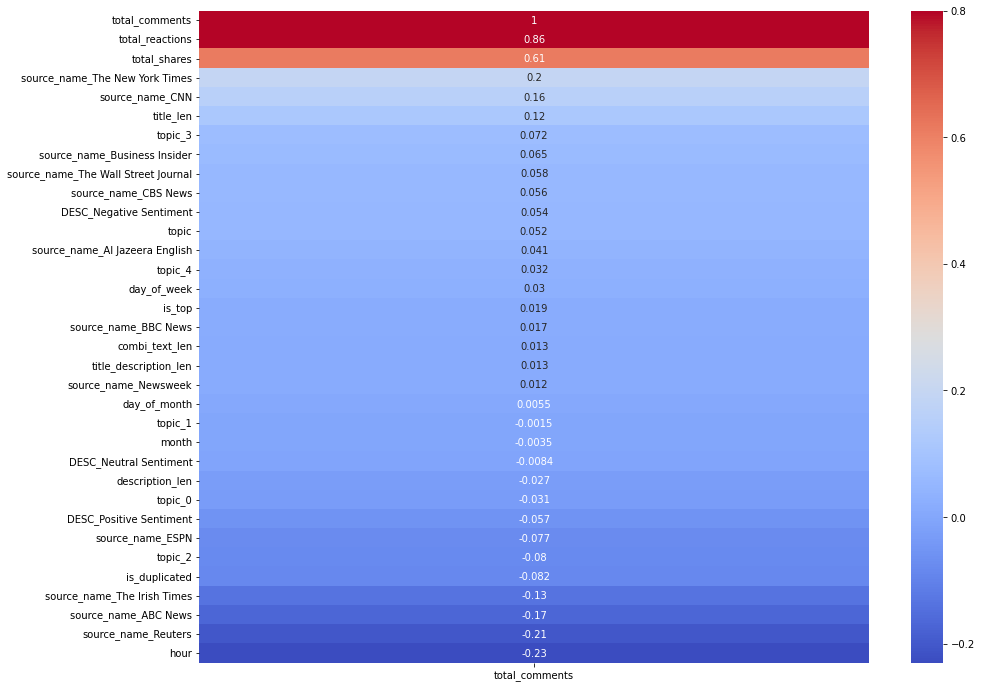

In [373]:
plt.figure(figsize=(15,12))
sns.heatmap(train.corr()[['total_comments']].sort_values(ascending=False, by='total_comments'), 
            cmap='coolwarm', annot=True, vmax=0.8)
plt.savefig('2')

In [353]:
top_feats = abs(df._get_numeric_data().corr()['total_shares']).sort_values(ascending=False).index[0:42]

In [365]:
print([col for col in df.columns if col not in top_feats])

['author', 'title', 'description', 'published_at', 'source_name', 'Sentiment', 'combi_text']


In [366]:
train = df[top_feats]

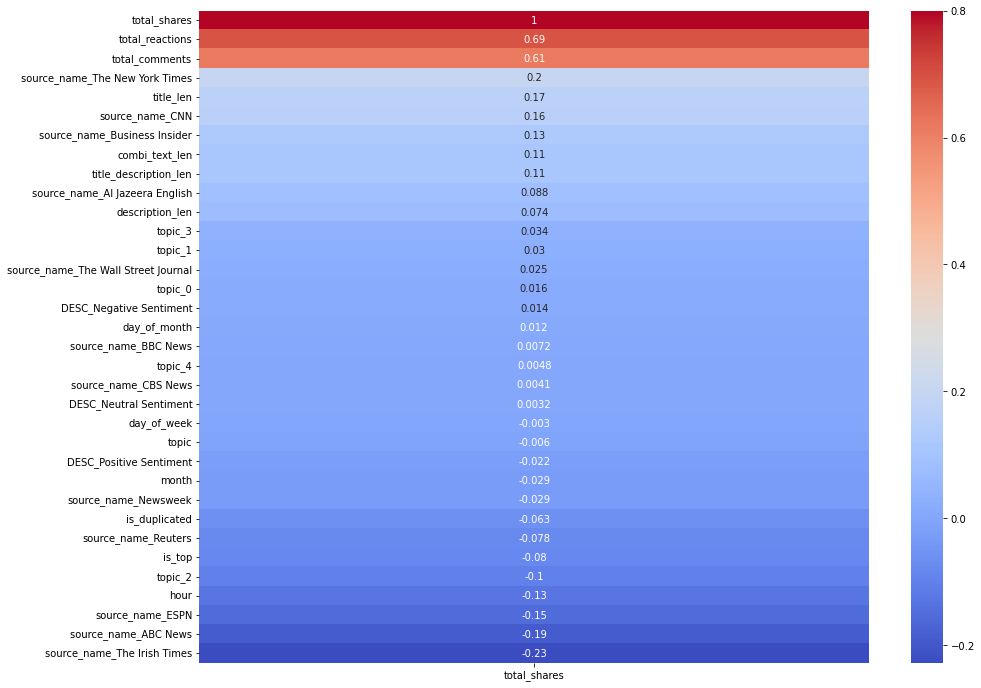

In [374]:
plt.figure(figsize=(15,12))
sns.heatmap(train.corr()[['total_shares']].sort_values(ascending=False, by='total_shares'), 
            cmap='coolwarm', annot=True, vmax=0.8)
plt.savefig('3')

In [370]:
top_feats = abs(df._get_numeric_data().corr()['total_reactions']).sort_values(ascending=False).index[0:42]

In [371]:
print([col for col in df.columns if col not in top_feats])

['author', 'title', 'description', 'published_at', 'source_name', 'Sentiment', 'combi_text']


In [285]:
train = df[top_feats]

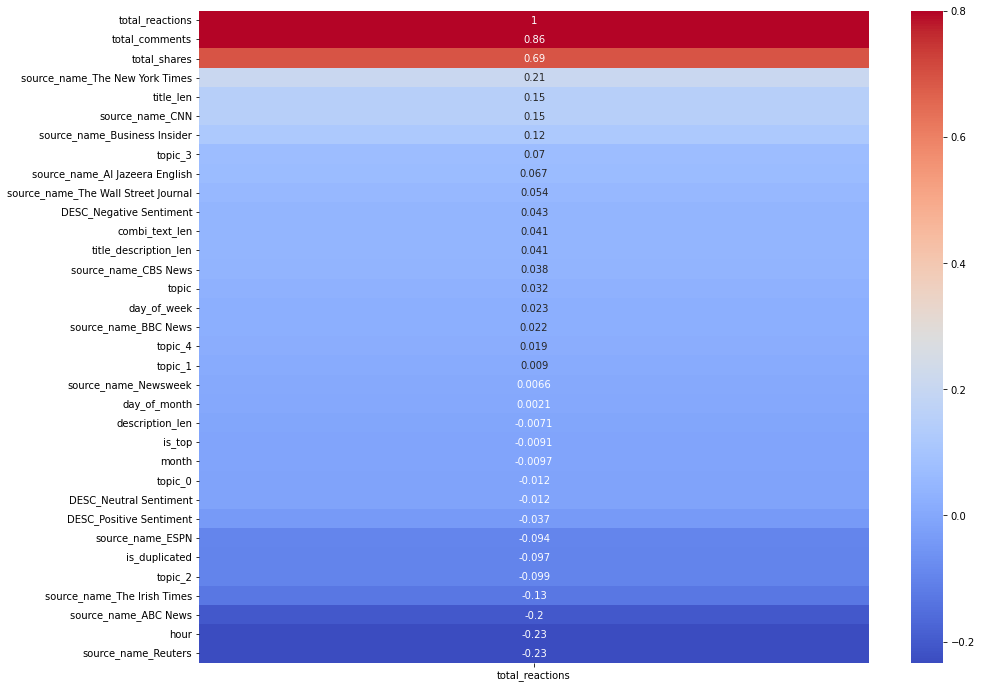

In [375]:
plt.figure(figsize=(15,12))
sns.heatmap(train.corr()[['total_reactions']].sort_values(ascending=False, by='total_reactions'), 
            cmap='coolwarm', annot=True, vmax=0.8)
plt.savefig('4')



---

